In [ ]:
# Mock data structure for picklings

elections = []

class Election:
    record = "some/path"
    codes = {
        "office" : False,
        "type" : True,
        "level" : True,
        "state": "Data Structure",
        "locality": "Data Structure",
        "datetime": "Datatime",
        "candidates": 0,
        "choices": 0,
    }
    measures = {
        "ashmans" : 0,
        "hartigan" : 0,
        "conistency" : 0,
    }
    calculations = {
        "mds_ordering" : 0,
        "candidate_names" : 0,
        "round_winners": {},
    }

In [ ]:
from scipy.stats import gaussian_kde
from scipy.integrate import trapz
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

In [ ]:
import pickle

# Specify the filename for the pickle file
pickle_filename = "election_consistency_points.pkl"

# Open the pickle file in read-binary mode and load the dictionary
with open(pickle_filename, 'rb') as f:
    election_consistency_points = pickle.load(f)

In [ ]:
def filter_elections(filter_criteria):
    """Filter the elections based on the given criteria."""
    election_df = pd.read_csv("election_table.csv")
    
    # Apply the filters
    for key, value in filter_criteria.items():
        if isinstance(value, list):  # Check if the filter value is a list
            election_df = election_df[election_df[key].isin(value)]  # Use .isin() for lists
        else:
            election_df = election_df[election_df[key] == value]
    
    filtered_elections = election_df['filename'].tolist()
    election_list = [election_consistency_points[election] for election in filtered_elections if election in election_consistency_points]
    for election in filtered_elections:
        print(election)
    
    return election_list

In [ ]:
def compute_kde(data_points, num_points=1000):
    """
    Compute Kernel Density Estimation (KDE) for given data points.
    
    Parameters:
    - data_points: List or array of data points.
    - num_points: Number of points for the KDE x-axis.
    
    Returns:
    - x_vals: X values for the kernal density estimation.
    - y_vals: Y values (density) for the kernal density estimation.
    """
    
    # Calculate kernel density estimation
    density = gaussian_kde(data_points)
    x_vals = np.linspace(min(data_points), max(data_points), num_points)
    y_vals = density(x_vals)
    
    return x_vals, y_vals

In [ ]:
def normalize_kde(kde_x, kde_y):
    """
    Normalize the KDE values:
    1. Scale x-values between 0 and 1.
    2. Ensure the area under the KDE curve is 1.
    
    Parameters:
    - kde_x: X values of the KDE.
    - kde_y: Y values (density) of the KDE.
    
    Returns:
    - normalized_x: Normalized x-values.
    - normalized_y: Normalized y-values.
    """
    
    # Scale x-values between 0 and 1
    min_x = min(kde_x)
    max_x = max(kde_x)
    normalized_x = (kde_x - min_x) / (max_x - min_x)
    
    # Ensure the area under the KDE curve is 1
    area = trapz(kde_y, normalized_x)
    normalized_y = kde_y / area
    
    return normalized_x, normalized_y

In [ ]:
def plot_kde(kde_x, kde_y, title='Kernel Density Estimation', xlabel='Value', ylabel='Density'):
    """
    Plot the KDE using the provided x and y values.
    
    Parameters:
    - kde_x: X values of the KDE.
    - kde_y: Y values (density) of the KDE.
    - title: Title for the plot.
    - xlabel: Label for x-axis.
    - ylabel: Label for y-axis.
    """
    plt.figure(figsize=(10, 6))
    plt.plot(kde_x, kde_y, label="KDE", color='blue')
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.grid(True)
    plt.legend()
    plt.show()

In [ ]:
def average_kdes(election_names, normalized_kde_data):
    """
    Average the KDEs for the provided list of election names.
    
    Parameters:
    - election_names: List of election names.
    - normalized_kde_data: Dictionary containing normalized KDE data for elections.
    
    Returns:
    - averaged_x: Averaged x-values for KDE.
    - averaged_y: Averaged y-values for KDE.
    """
    
    # Check if election_names is not empty
    if not election_names:
        raise ValueError("The list of election names is empty.")
    
    first_election = str(election_names[0])
    
    # Initialize accumulators for KDE values
    sum_x = np.zeros_like(normalized_kde_data[first_election][0])
    sum_y = np.zeros_like(normalized_kde_data[first_election][1])
    
    # Accumulate KDE values
    for election in election_names:
        election_str = str(election)  # Ensure that the key used is a string
        sum_x += normalized_kde_data[election_str][0]
        sum_y += normalized_kde_data[election_str][1]
    
    # Calculate the average
    num_elections = len(election_names)
    averaged_x = sum_x / num_elections
    averaged_y = sum_y / num_elections
    
    return averaged_x, averaged_y

def average_and_plot(election_names, title):
    """
    Average the KDEs for the provided list of election names and plot the result.
    
    Parameters:
    - election_names: List of election names.
    - title: Title for the plot.
    """
    
    averaged_x, averaged_y = average_kdes(election_names, normalized_kde_data)
    plot_kde(averaged_x, averaged_y, title=title)

In [32]:
import numpy as np
import pandas as pd
import pickle
from scipy.stats import gaussian_kde
from scipy.integrate import trapz
import matplotlib.pyplot as plt
import seaborn as sns

# Load the normalized KDE data from the pickle file
with open("election_kde_normalized.pkl", 'rb') as f:
    normalized_kde_data = pickle.load(f)

# Function to compute KDE
def compute_kde(data_points, num_points=1000):
    density = gaussian_kde(data_points)
    x_vals = np.linspace(min(data_points), max(data_points), num_points)
    y_vals = density(x_vals)
    return x_vals, y_vals

# Function to normalize KDE
def normalize_kde(kde_x, kde_y):
    min_x = min(kde_x)
    max_x = max(kde_x)
    normalized_x = (kde_x - min_x) / (max_x - min_x)
    area = trapz(kde_y, normalized_x)
    normalized_y = kde_y / area
    return normalized_x, normalized_y

# Function to plot KDE
def plot_kde(kde_x, kde_y, title='Kernel Density Estimation'):
    plt.figure(figsize=(10, 6))
    plt.plot(kde_x, kde_y, label="KDE", color='blue')
    plt.title(title)
    plt.xlabel('Value')
    plt.ylabel('Density')
    plt.grid(True)
    plt.legend()
    plt.show()

# Function to average KDEs
def average_kdes(election_names, normalized_kde_data):
    print(election_names)
    print(normalized_kde_data)
    sum_x = np.zeros_like(normalized_kde_data[election_names[0]][0])
    sum_y = np.zeros_like(normalized_kde_data[election_names[0]][1])
    for election in election_names:
        print(election)
        sum_x += normalized_kde_data[election][0]
        sum_y += normalized_kde_data[election][1]
    num_elections = len(election_names)
    averaged_x = sum_x / num_elections
    averaged_y = sum_y / num_elections
    return averaged_x, averaged_y

# Function to average and plot KDEs
def average_and_plot(election_names, title):
    averaged_x, averaged_y = average_kdes(election_names, normalized_kde_data)
    plot_kde(averaged_x, averaged_y, title=title)

# Function to filter elections
def filter_elections(filter_criteria):
    election_df = pd.read_csv("election_table.csv")
    for key, value in filter_criteria.items():
        if isinstance(value, list):
            election_df = election_df[election_df[key].isin(value)]
        else:
            election_df = election_df[election_df[key] == value]
    filtered_elections = election_df['filename'].tolist()
    election_list = [election for election in filtered_elections if election in normalized_kde_data]
    return election_list

Alaska_08162022_HouseofRepresentativesSpecial.csv
Alaska_11082022_USRepresentative.csv
Maine_11062018_CongressionalDistrict2.csv
Maine_11082022_CongressionalDistrict2.csv
Alaska_11082022_USSenator.csv
Alaska_11082022_GovernorLieutenantGovernor.csv
Alaska_11082022_HouseDistrict1.csv
Alaska_11082022_HouseDistrict2.csv
Alaska_11082022_HouseDistrict4.csv
Alaska_11082022_HouseDistrict5.csv
Alaska_11082022_HouseDistrict6.csv
Alaska_11082022_HouseDistrict7.csv
Alaska_11082022_HouseDistrict9.csv
Alaska_11082022_HouseDistrict10.csv
Alaska_11082022_HouseDistrict11.csv
Alaska_11082022_HouseDistrict12.csv
Alaska_11082022_HouseDistrict13.csv
Alaska_11082022_HouseDistrict14.csv
Alaska_11082022_HouseDistrict15.csv
Alaska_11082022_HouseDistrict16.csv
Alaska_11082022_HouseDistrict17.csv
Alaska_11082022_HouseDistrict18.csv
Alaska_11082022_HouseDistrict19.csv
Alaska_11082022_HouseDistrict20.csv
Alaska_11082022_HouseDistrict21.csv
Alaska_11082022_HouseDistrict22.csv
Alaska_11082022_HouseDistrict23.csv
Ala

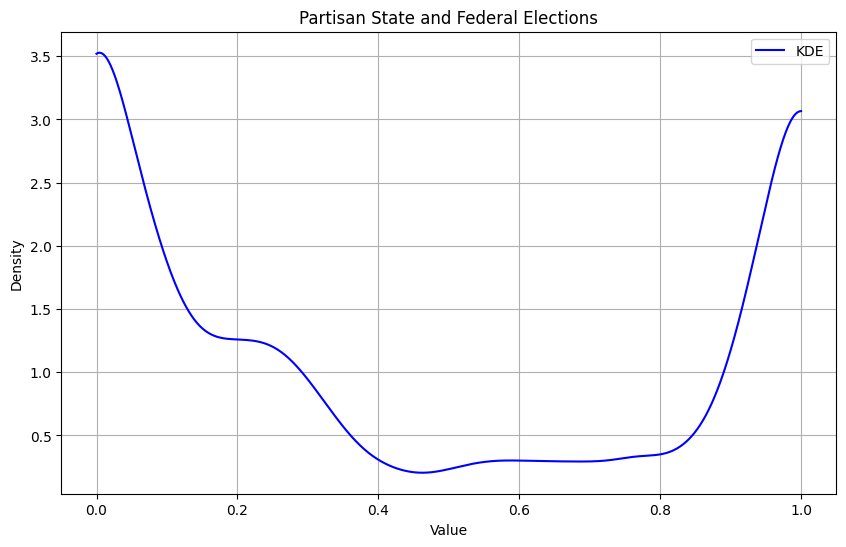

Albany_11082022_BoardofEducation.csv
Minneapolis_11022021_ParkBoardAtLarge.csv
Minneapolis_11022021_ParkBoardDistrict2.csv
Minneapolis_11022021_ParkBoardDistrict3.csv
Minneapolis_11022021_ParkBoardDistrict4.csv
Minneapolis_11022021_ParkBoardDistrict5.csv
Minneapolis_11022021_ParkBoardDistrict6.csv
Minneapolis_11052013_PRBoardDistrict2.csv
Minneapolis_11052013_PRBoardDistrict6.csv
Minneapolis_11062009_PRBoardDistrict1.csv
Minneapolis_11062009_PRBoardDistrict2.csv
Minneapolis_11062009_PRBoardDistrict3.csv
Minneapolis_11062009_PRBoardDistrict5.csv
Minneapolis_11062009_PRBoardDistrict6.csv
Minneapolis_11072017_PRBoardDistrict1.csv
Minneapolis_11072017_PRBoardDistrict2.csv
Minneapolis_11072017_PRBoardDistrict3.csv
Minneapolis_11072017_PRBoardDistrict4.csv
Minneapolis_11072017_PRBoardDistrict5.csv
Minneapolis_11072017_PRBoardDistrict6.csv
Oakland_11022010_SchoolDirectorDistrict4.csv
Oakland_11032020_SchoolDirectorDist1OaklandRCV.csv
Oakland_11032020_SchoolDirectorDist3OaklandRCV.csv
Oakland_

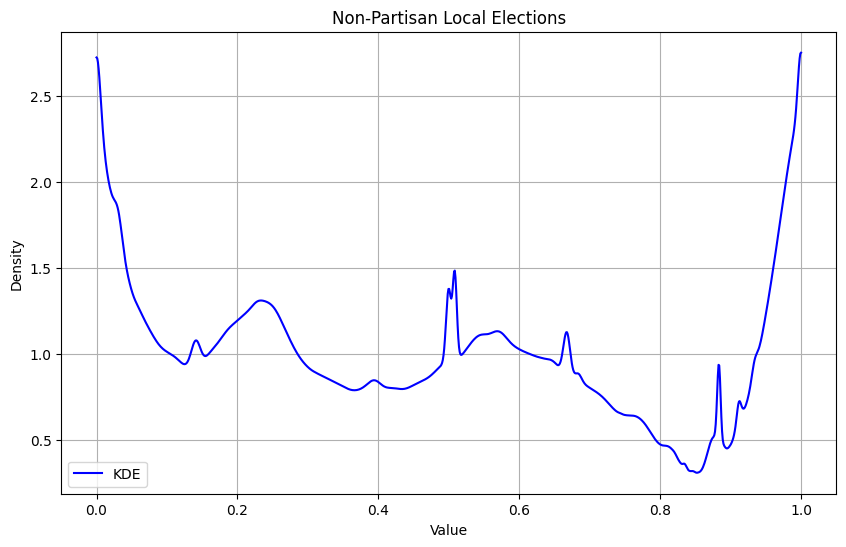

Testing for target election:
['Alaska_11082022_USRepresentative.csv']
{'Minneapolis_11072017_BoardofEstimateandTaxation.csv': (array([0.        , 0.001001  , 0.002002  , 0.003003  , 0.004004  ,
       0.00500501, 0.00600601, 0.00700701, 0.00800801, 0.00900901,
       0.01001001, 0.01101101, 0.01201201, 0.01301301, 0.01401401,
       0.01501502, 0.01601602, 0.01701702, 0.01801802, 0.01901902,
       0.02002002, 0.02102102, 0.02202202, 0.02302302, 0.02402402,
       0.02502503, 0.02602603, 0.02702703, 0.02802803, 0.02902903,
       0.03003003, 0.03103103, 0.03203203, 0.03303303, 0.03403403,
       0.03503504, 0.03603604, 0.03703704, 0.03803804, 0.03903904,
       0.04004004, 0.04104104, 0.04204204, 0.04304304, 0.04404404,
       0.04504505, 0.04604605, 0.04704705, 0.04804805, 0.04904905,
       0.05005005, 0.05105105, 0.05205205, 0.05305305, 0.05405405,
       0.05505506, 0.05605606, 0.05705706, 0.05805806, 0.05905906,
       0.06006006, 0.06106106, 0.06206206, 0.06306306, 0.06406406,
  

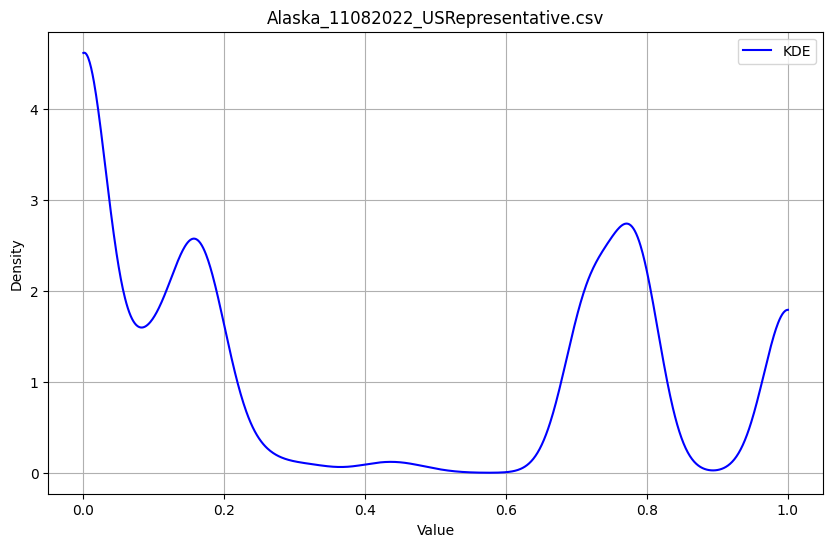

In [33]:
# Filter and average for STATE and FEDERAL level elections with YES in partisan
filter_criteria = {'level': ['FEDERAL', 'STATE'], 'partisan': 'YES'}
state_federal_points = filter_elections(filter_criteria)
for election in state_federal_points:
    print(election)
print("(Method 1) Averaging for STATE and FEDERAL level elections with YES in partisan:")
average_and_plot(state_federal_points, "Partisan State and Federal Elections")

# Filter and average for LOCAL elections with NO in partisan
filter_criteria = {'level': 'LOCAL', 'partisan': 'NO'}
local_points = filter_elections(filter_criteria)
for election in local_points:
    print(election)
print("(Method 1) Averaging for LOCAL elections with NO in partisan:")
average_and_plot(local_points, "Non-Partisan Local Elections")

# Testing for a single election
print("Testing for target election:")
average_and_plot(["Alaska_11082022_USRepresentative.csv"], "Alaska_11082022_USRepresentative.csv")

In [38]:
# Function to normalize KDE ensuring that majority of the area is on the left side of the distribution
def normalize_kde(kde_x, kde_y):
    
    # Normalize KDE
    min_x = min(kde_x)
    max_x = max(kde_x)
    normalized_x = (kde_x - min_x) / (max_x - min_x)
    area = trapz(kde_y, normalized_x)
    normalized_y = kde_y / area
    
    # Calculate area to the left of midpoint for normalized KDE
    midpoint_idx = np.searchsorted(normalized_x, 0.5)
    area_left_original = trapz(normalized_y[:midpoint_idx], normalized_x[:midpoint_idx])
    
    # Calculate area to the left of midpoint for flipped KDE
    flipped_x = 1 - normalized_x
    flipped_y = normalized_y[::-1]
    area_left_flipped = trapz(flipped_y[:midpoint_idx], flipped_x[:midpoint_idx])
    
    # Return the KDE with the larger area to the left of the midpoint
    if area_left_flipped > area_left_original:
        return flipped_x, flipped_y
    else:
        return normalized_x, normalized_y

Alaska_08162022_HouseofRepresentativesSpecial.csv
Alaska_11082022_USRepresentative.csv
Maine_11062018_CongressionalDistrict2.csv
Maine_11082022_CongressionalDistrict2.csv
Alaska_11082022_USSenator.csv
Alaska_11082022_GovernorLieutenantGovernor.csv
Alaska_11082022_HouseDistrict1.csv
Alaska_11082022_HouseDistrict2.csv
Alaska_11082022_HouseDistrict4.csv
Alaska_11082022_HouseDistrict5.csv
Alaska_11082022_HouseDistrict6.csv
Alaska_11082022_HouseDistrict7.csv
Alaska_11082022_HouseDistrict9.csv
Alaska_11082022_HouseDistrict10.csv
Alaska_11082022_HouseDistrict11.csv
Alaska_11082022_HouseDistrict12.csv
Alaska_11082022_HouseDistrict13.csv
Alaska_11082022_HouseDistrict14.csv
Alaska_11082022_HouseDistrict15.csv
Alaska_11082022_HouseDistrict16.csv
Alaska_11082022_HouseDistrict17.csv
Alaska_11082022_HouseDistrict18.csv
Alaska_11082022_HouseDistrict19.csv
Alaska_11082022_HouseDistrict20.csv
Alaska_11082022_HouseDistrict21.csv
Alaska_11082022_HouseDistrict22.csv
Alaska_11082022_HouseDistrict23.csv
Ala

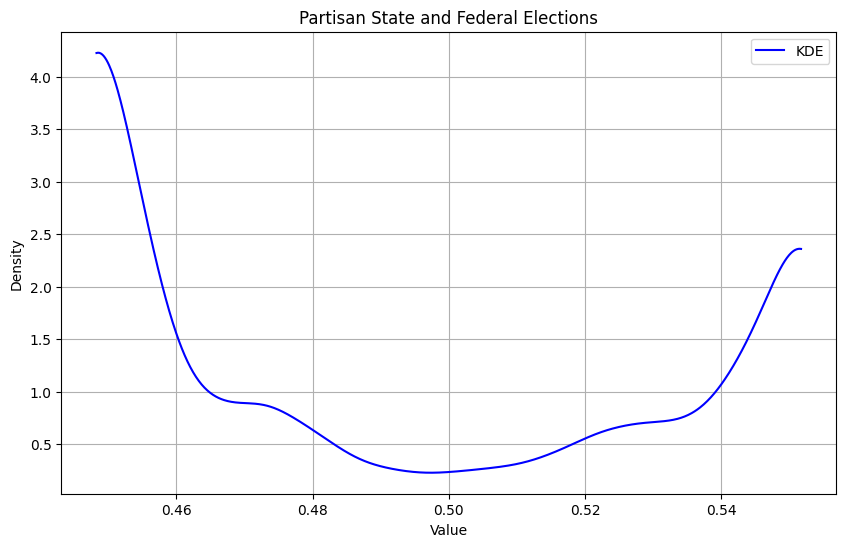

Albany_11082022_BoardofEducation.csv
Minneapolis_11022021_ParkBoardAtLarge.csv
Minneapolis_11022021_ParkBoardDistrict2.csv
Minneapolis_11022021_ParkBoardDistrict3.csv
Minneapolis_11022021_ParkBoardDistrict4.csv
Minneapolis_11022021_ParkBoardDistrict5.csv
Minneapolis_11022021_ParkBoardDistrict6.csv
Minneapolis_11052013_PRBoardDistrict2.csv
Minneapolis_11052013_PRBoardDistrict6.csv
Minneapolis_11062009_PRBoardDistrict1.csv
Minneapolis_11062009_PRBoardDistrict2.csv
Minneapolis_11062009_PRBoardDistrict3.csv
Minneapolis_11062009_PRBoardDistrict5.csv
Minneapolis_11062009_PRBoardDistrict6.csv
Minneapolis_11072017_PRBoardDistrict1.csv
Minneapolis_11072017_PRBoardDistrict2.csv
Minneapolis_11072017_PRBoardDistrict3.csv
Minneapolis_11072017_PRBoardDistrict4.csv
Minneapolis_11072017_PRBoardDistrict5.csv
Minneapolis_11072017_PRBoardDistrict6.csv
Oakland_11022010_SchoolDirectorDistrict4.csv
Oakland_11032020_SchoolDirectorDist1OaklandRCV.csv
Oakland_11032020_SchoolDirectorDist3OaklandRCV.csv
Oakland_

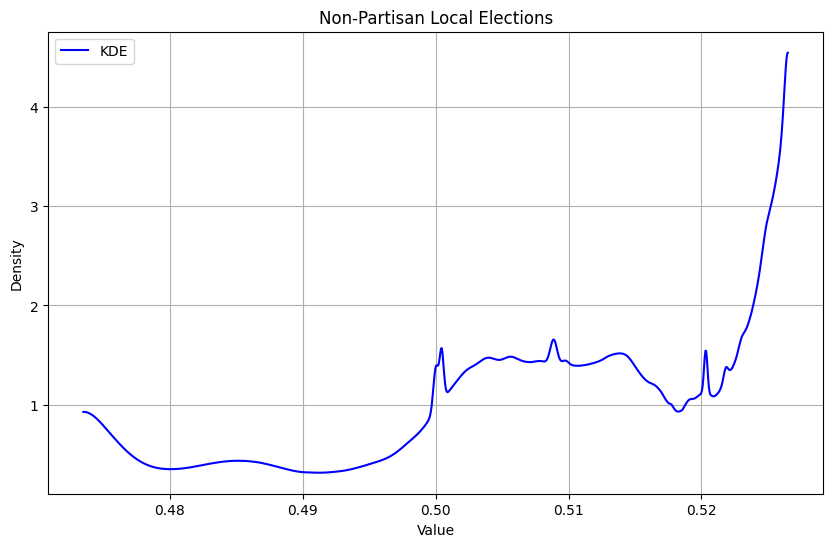

Testing for target election:


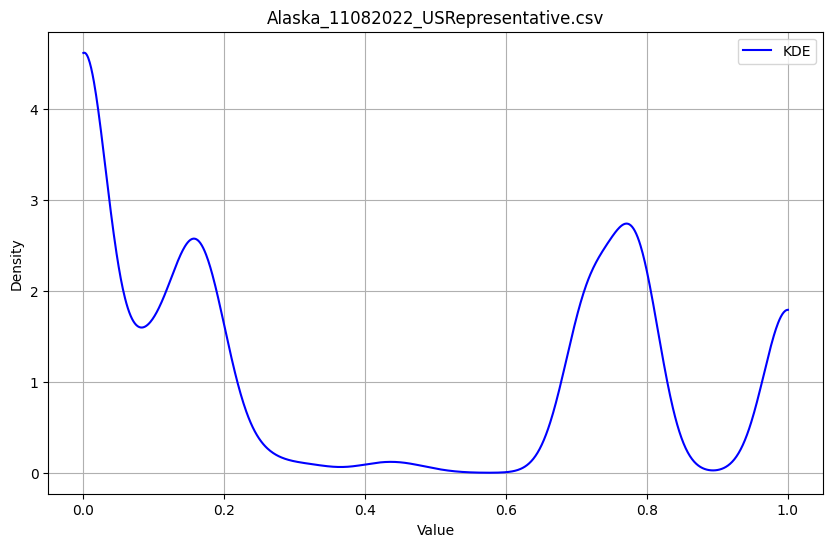

In [39]:
# Load the normalized KDE data from the pickle file
with open("election_kde_normalized.pkl", 'rb') as f:
    normalized_kde_data = pickle.load(f)

# Filter and average for STATE and FEDERAL level elections with YES in partisan
filter_criteria = {'level': ['FEDERAL', 'STATE'], 'partisan': 'YES'}
state_federal_points = filter_elections(filter_criteria)
for election in state_federal_points:
    print(election)
print("(Method 2) Averaging for STATE and FEDERAL level elections with YES in partisan:")
average_and_plot(state_federal_points, "Partisan State and Federal Elections")

# Filter and average for LOCAL elections with NO in partisan
filter_criteria = {'level': 'LOCAL', 'partisan': 'NO'}
local_points = filter_elections(filter_criteria)
for election in local_points:
    print(election)
print("(Method 2) Averaging for LOCAL elections with NO in partisan:")
average_and_plot(local_points, "Non-Partisan Local Elections")

# Testing for a single election
print("Testing for target election:")
average_and_plot(["Alaska_11082022_USRepresentative.csv"], "Alaska_11082022_USRepresentative.csv")

In [ ]:
# Dictionary to store normalized KDE values for each election
normalized_kde_data = {}

# Computing and normalizing KDE for each election in the pickled data
for filename, points in election_consistency_points.items():
    data_points = [x for x, count in points.items() for _ in range(count)]
    kde_x, kde_y = compute_kde(data_points)
    normalized_kde_x, normalized_kde_y = normalize_kde(kde_x, kde_y)
    normalized_kde_data[filename] = (normalized_kde_x, normalized_kde_y)

# Save the normalized KDE data to a new pickle file
with open("election_kde_normalized.pkl", 'wb') as f:
    pickle.dump(normalized_kde_data, f)

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import gaussian_kde
import numpy as np

def average_and_plot(points_list, title="Averaged Data Analysis"):
    
    # Grid for KDE evaluation
    x_grid = np.linspace(0, 1, 500)
    kde_values_list = []
    
    # Normalize, scale and compute KDE for each election
    for points in points_list:
        # Normalize x-values
        abs_max_x = max(abs(min(points.keys())), abs(max(points.keys())))
        normalized_data = [(x + abs_max_x) / (2 * abs_max_x) for x in points.keys()]
        
        # Scale y-values
        max_y = max(points.values())
        scaled_weights = [v / max_y for v in points.values()]
        
        # Compute KDE values
        kde = gaussian_kde(normalized_data, weights=scaled_weights)
        kde_values_list.append(kde(x_grid))
    
    # Average the KDE values across all elections
    avg_kde = np.mean(kde_values_list, axis=0)
    
    # Plot the averaged KDE
    plt.figure(figsize=(10, 6))
    plt.plot(x_grid, avg_kde)
    plt.title(f"{title} - Kernel Density Estimation")
    plt.xlabel('Value')
    plt.ylabel('Density')
    plt.grid(True)
    plt.show()

In [ ]:
# Filter and average for STATE and FEDERAL level elections with YES in partisan
filter_criteria = {'level': ['FEDERAL', 'STATE'], 'partisan': 'YES'}
state_federal_points = filter_elections(filter_criteria)
print("(Method 1) Averaging for STATE and FEDERAL level elections with YES in partisan:")
average_and_plot(state_federal_points, "Partisan State and Federal Elections")

# Filter and average for LOCAL elections with NO in partisan
filter_criteria = {'level': 'LOCAL', 'partisan': 'NO'}
local_points = filter_elections(filter_criteria)
print("(Method 1) Averaging for LOCAL elections with NO in partisan:")
average_and_plot(local_points, "Non-Partisan Local Elections")

# Testing for a single election
print("Testing for target election:")
average_and_plot([election_consistency_points["Alaska_11082022_USRepresentative.csv"]], "Alaska_11082022_USRepresentative.csv")

In [ ]:
import matplotlib.pyplot as plt

def plot_kdes(kdes, x_grid, title="KDE Analysis"):
    """Plot the computed KDEs."""
    
    plt.figure(figsize=(10, 6))
    
    for kde_values in kdes:
        plt.plot(x_grid, kde_values)
    
    plt.title(title)
    plt.xlabel('Value')
    plt.ylabel('Density')
    plt.grid(True)
    plt.show()

In [ ]:
from scipy.stats import gaussian_kde
import numpy as np

def compute_kdes(points_list):
    """Compute KDE for each election."""
    
    kdes = []
    x_grid = np.linspace(0, 1, 500)  # Define a grid to evaluate the KDEs
    
    # Normalize and compute KDE for each election
    for points in points_list:
        # Normalize x-values
        abs_max_x = max(abs(min(points.keys())), abs(max(points.keys())))
        normalized_data = [(x + abs_max_x) / (2 * abs_max_x) for x in points.keys()]
        
        # Compute KDE and evaluate it on the x_grid
        kde = gaussian_kde(normalized_data)
        kde_values = kde(x_grid)
        
        kdes.append(kde_values)
    
    return kdes, x_grid

In [ ]:
# Filter and compute KDE for STATE and FEDERAL level elections with YES in partisan
filter_criteria = {'level': ['FEDERAL', 'STATE'], 'partisan': 'YES'}
state_federal_points = filter_elections(filter_criteria)
print("Computing KDE for STATE and FEDERAL level elections with YES in partisan:")
kdes, x_grid = compute_kdes(state_federal_points)
plot_kdes(kdes, x_grid, "Partisan State and Federal Elections KDEs")

# Filter and compute KDE for LOCAL elections with NO in partisan
filter_criteria = {'level': 'LOCAL', 'partisan': 'NO'}
local_points = filter_elections(filter_criteria)
print("Computing KDE for LOCAL elections with NO in partisan:")
kdes, x_grid = compute_kdes(local_points)
plot_kdes(kdes, x_grid, "Non-Partisan Local Elections KDEs")

# Compute and plot KDE for a single election
print("Computing KDE for target election:")
kdes, x_grid = compute_kdes([election_consistency_points["Alaska_11082022_USRepresentative.csv"]])
plot_kdes(kdes, x_grid, "Alaska_11082022_USRepresentative.csv KDE")